In [1]:
# operating system
import os
import sys

# plotting libraries
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import colormaps

# data loading libraries
from src.data_loader import DRONE_RCS_CSV_TO_XARRAY,visualize_RCS_dictionary

# array manipulation
import xarray as xr
import numpy as np
import pandas as pd

# skimage
import skimage
from skimage import data, img_as_float
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import normalized_root_mse as nrmse
from skimage.metrics import normalized_mutual_information as nmi

# torch metrics
from torchmetrics.image import MultiScaleStructuralSimilarityIndexMeasure
import torch

# misc
import itertools
from tqdm import tqdm

C:\Users\lpott\anaconda3\envs\jaxtorch\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
DRONE_RCS_FOLDER = "Drone_RCS_Measurement_Dataset" #r"..\Drone_RCS_Measurement_Dataset"

In [3]:
drone_rcs,labe_encoder = DRONE_RCS_CSV_TO_XARRAY(DRONE_RCS_FOLDER,visualize=False)

[(7, 'battery_HH'), (0, 'F450_HH'), (1, 'Heli_HH'), (2, 'Hexa_HH'), (3, 'M100_HH'), (4, 'P4P_HH'), (5, 'Walkera_HH'), (6, 'Y600_HH')]


7
@26GHz Min RCS -67.561 , Max RCS 4.423
@27GHz Min RCS -58.590 , Max RCS 2.919
@28GHz Min RCS -53.286 , Max RCS 3.143
@29GHz Min RCS -62.244 , Max RCS 4.940
@30GHz Min RCS -59.917 , Max RCS 3.559
@31GHz Min RCS -53.869 , Max RCS 4.575
@32GHz Min RCS -58.985 , Max RCS 5.985
@33GHz Min RCS -65.375 , Max RCS 6.401
@34GHz Min RCS -60.425 , Max RCS 5.426
@35GHz Min RCS -67.829 , Max RCS 6.299
@36GHz Min RCS -59.528 , Max RCS 6.845
@37GHz Min RCS -58.333 , Max RCS 6.336
@38GHz Min RCS -62.327 , Max RCS 7.897
@39GHz Min RCS -56.948 , Max RCS 10.955
@40GHz Min RCS -64.535 , Max RCS 8.777



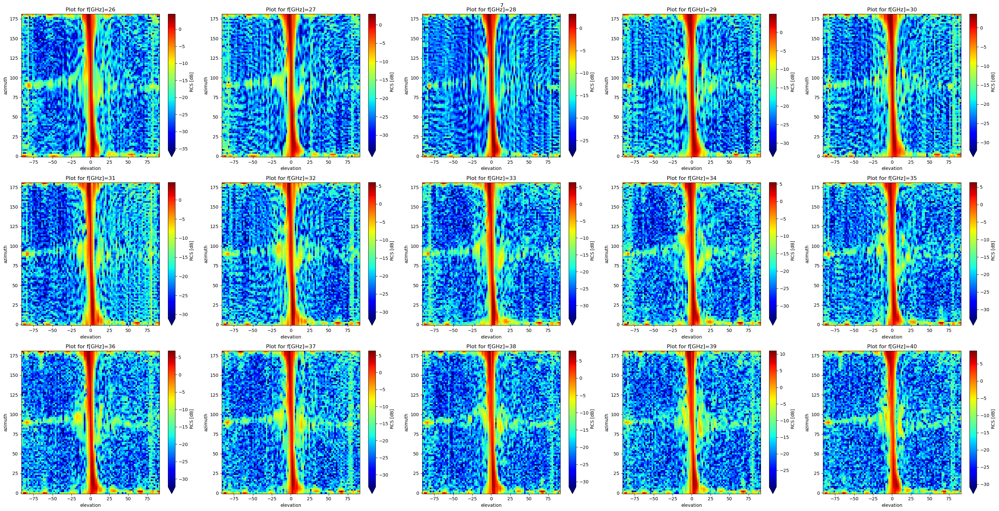

0
@26GHz Min RCS -68.659 , Max RCS 3.199
@27GHz Min RCS -61.211 , Max RCS 3.904
@28GHz Min RCS -62.823 , Max RCS 5.266
@29GHz Min RCS -59.036 , Max RCS 8.974
@30GHz Min RCS -71.563 , Max RCS 7.316
@31GHz Min RCS -58.576 , Max RCS 4.588
@32GHz Min RCS -63.946 , Max RCS 5.651
@33GHz Min RCS -59.600 , Max RCS 6.812
@34GHz Min RCS -69.283 , Max RCS 7.956
@35GHz Min RCS -58.113 , Max RCS 5.759
@36GHz Min RCS -70.210 , Max RCS 7.881
@37GHz Min RCS -60.686 , Max RCS 4.307
@38GHz Min RCS -66.307 , Max RCS 7.865
@39GHz Min RCS -67.824 , Max RCS 10.431
@40GHz Min RCS -61.761 , Max RCS 8.590



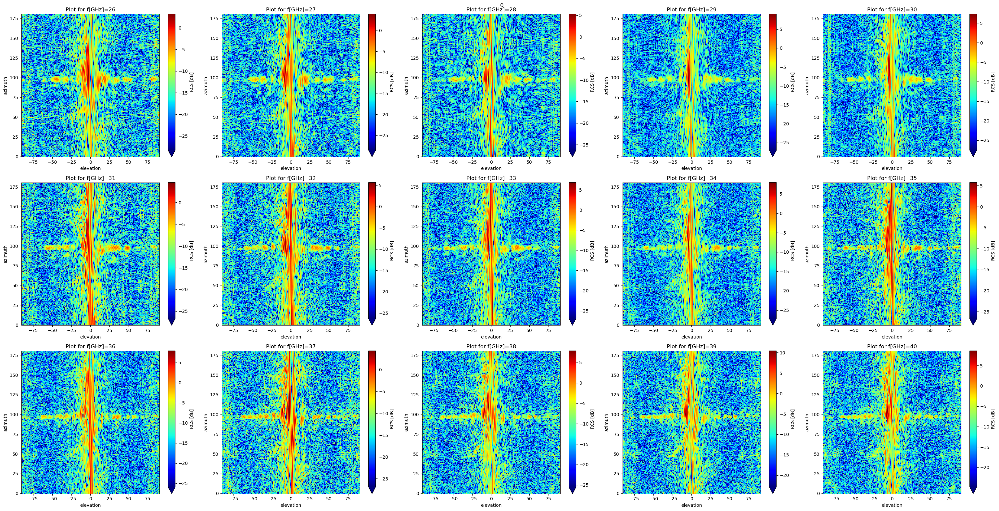

1
@26GHz Min RCS -58.898 , Max RCS 0.556
@27GHz Min RCS -65.520 , Max RCS -0.548
@28GHz Min RCS -55.602 , Max RCS 0.778
@29GHz Min RCS -64.128 , Max RCS 3.707
@30GHz Min RCS -62.508 , Max RCS 2.051
@31GHz Min RCS -71.166 , Max RCS 2.898
@32GHz Min RCS -56.940 , Max RCS 2.600
@33GHz Min RCS -55.238 , Max RCS 2.531
@34GHz Min RCS -56.031 , Max RCS 1.634
@35GHz Min RCS -53.606 , Max RCS 3.753
@36GHz Min RCS -64.392 , Max RCS 5.254
@37GHz Min RCS -58.687 , Max RCS 3.575
@38GHz Min RCS -52.951 , Max RCS 4.292
@39GHz Min RCS -49.430 , Max RCS 7.190
@40GHz Min RCS -56.842 , Max RCS 6.855



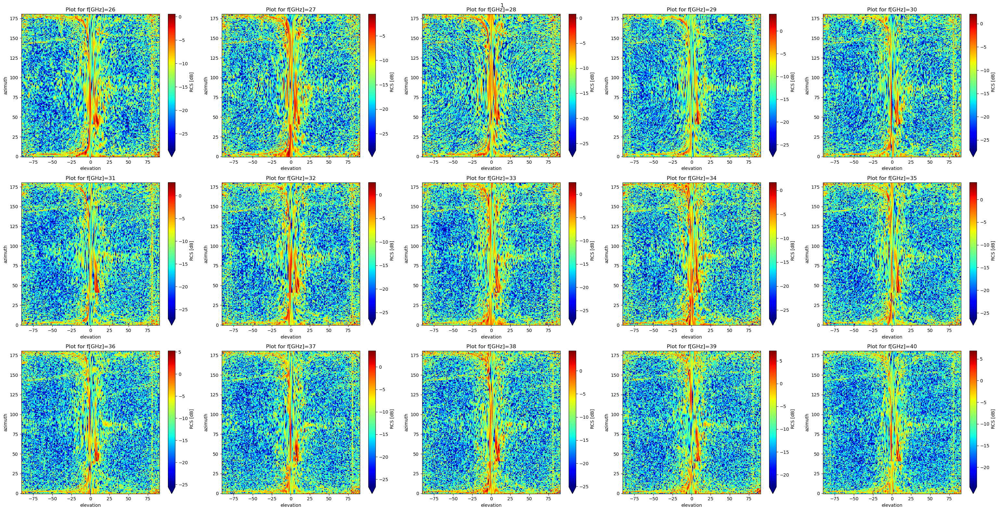

2
@26GHz Min RCS -56.585 , Max RCS 9.953
@27GHz Min RCS -55.382 , Max RCS 10.029
@28GHz Min RCS -52.379 , Max RCS 11.689
@29GHz Min RCS -58.695 , Max RCS 10.152
@30GHz Min RCS -48.411 , Max RCS 10.668
@31GHz Min RCS -54.066 , Max RCS 10.483
@32GHz Min RCS -58.230 , Max RCS 11.953
@33GHz Min RCS -53.368 , Max RCS 11.728
@34GHz Min RCS -51.327 , Max RCS 12.924
@35GHz Min RCS -70.967 , Max RCS 12.902
@36GHz Min RCS -49.821 , Max RCS 12.729
@37GHz Min RCS -53.607 , Max RCS 13.947
@38GHz Min RCS -50.385 , Max RCS 14.609
@39GHz Min RCS -51.996 , Max RCS 16.164
@40GHz Min RCS -45.385 , Max RCS 15.605



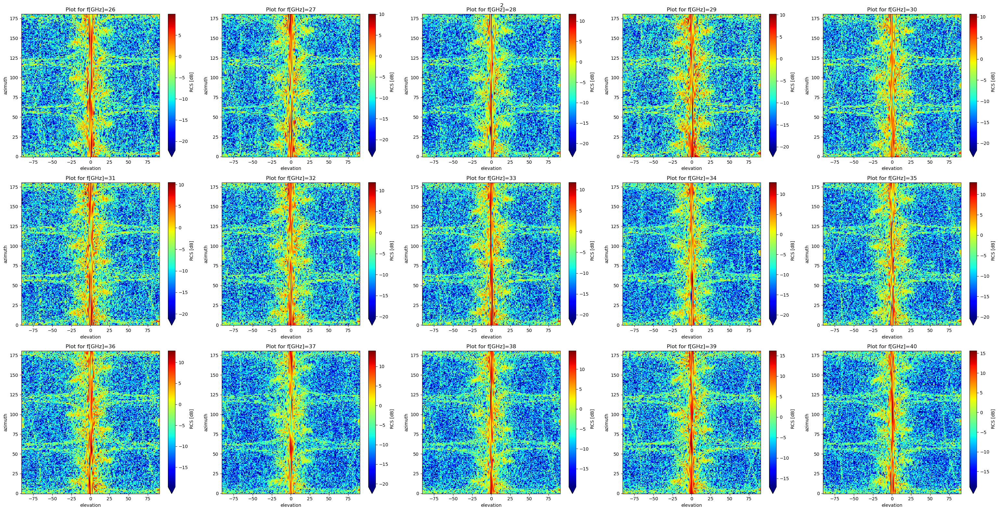

3
@26GHz Min RCS -58.446 , Max RCS 14.230
@27GHz Min RCS -52.444 , Max RCS 12.260
@28GHz Min RCS -63.678 , Max RCS 18.328
@29GHz Min RCS -55.473 , Max RCS 17.067
@30GHz Min RCS -51.476 , Max RCS 15.416
@31GHz Min RCS -59.599 , Max RCS 20.743
@32GHz Min RCS -56.585 , Max RCS 18.881
@33GHz Min RCS -66.012 , Max RCS 14.975
@34GHz Min RCS -57.239 , Max RCS 17.304
@35GHz Min RCS -62.048 , Max RCS 16.649
@36GHz Min RCS -54.707 , Max RCS 19.267
@37GHz Min RCS -53.730 , Max RCS 19.898
@38GHz Min RCS -65.606 , Max RCS 19.064
@39GHz Min RCS -67.407 , Max RCS 22.096
@40GHz Min RCS -62.978 , Max RCS 22.257



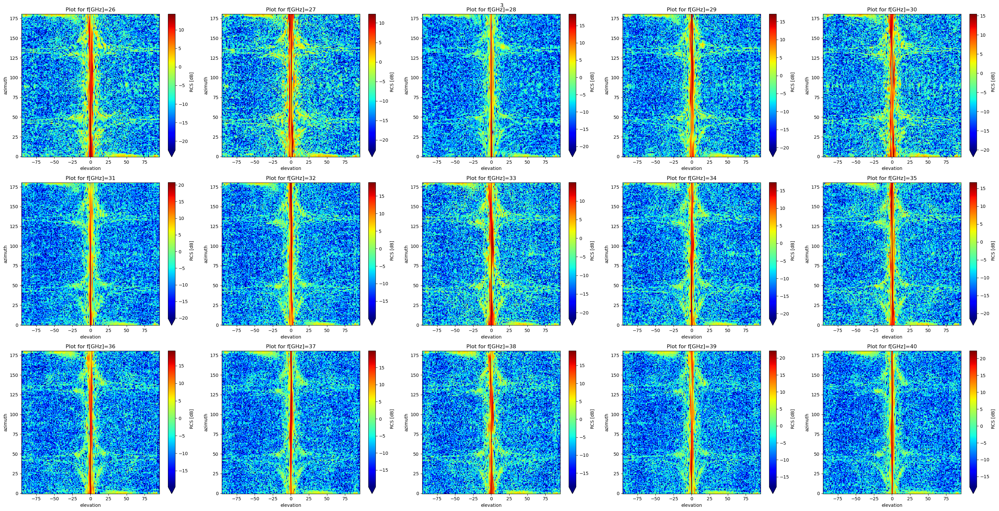

4
@26GHz Min RCS -63.795 , Max RCS -1.883
@27GHz Min RCS -59.878 , Max RCS -2.113
@28GHz Min RCS -54.602 , Max RCS -0.721
@29GHz Min RCS -54.453 , Max RCS 0.954
@30GHz Min RCS -63.577 , Max RCS -0.546
@31GHz Min RCS -51.087 , Max RCS 2.174
@32GHz Min RCS -62.112 , Max RCS 0.194
@33GHz Min RCS -70.931 , Max RCS 0.192
@34GHz Min RCS -68.776 , Max RCS -0.462
@35GHz Min RCS -62.660 , Max RCS 1.041
@36GHz Min RCS -66.591 , Max RCS 1.626
@37GHz Min RCS -58.098 , Max RCS 0.516
@38GHz Min RCS -58.962 , Max RCS 2.284
@39GHz Min RCS -63.957 , Max RCS 2.622
@40GHz Min RCS -57.482 , Max RCS 2.995



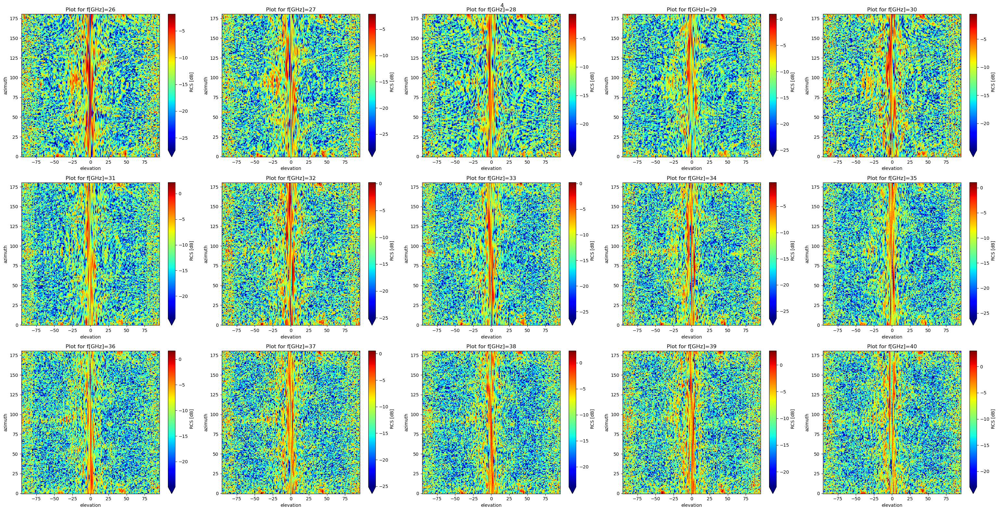

5
@26GHz Min RCS -53.831 , Max RCS 8.066
@27GHz Min RCS -52.108 , Max RCS 5.588
@28GHz Min RCS -58.612 , Max RCS 8.831
@29GHz Min RCS -51.440 , Max RCS 8.229
@30GHz Min RCS -52.870 , Max RCS 7.586
@31GHz Min RCS -70.126 , Max RCS 10.397
@32GHz Min RCS -66.929 , Max RCS 9.941
@33GHz Min RCS -55.195 , Max RCS 8.832
@34GHz Min RCS -63.711 , Max RCS 8.093
@35GHz Min RCS -56.488 , Max RCS 8.599
@36GHz Min RCS -54.750 , Max RCS 11.052
@37GHz Min RCS -58.861 , Max RCS 9.226
@38GHz Min RCS -53.839 , Max RCS 10.991
@39GHz Min RCS -51.129 , Max RCS 11.707
@40GHz Min RCS -60.679 , Max RCS 10.143



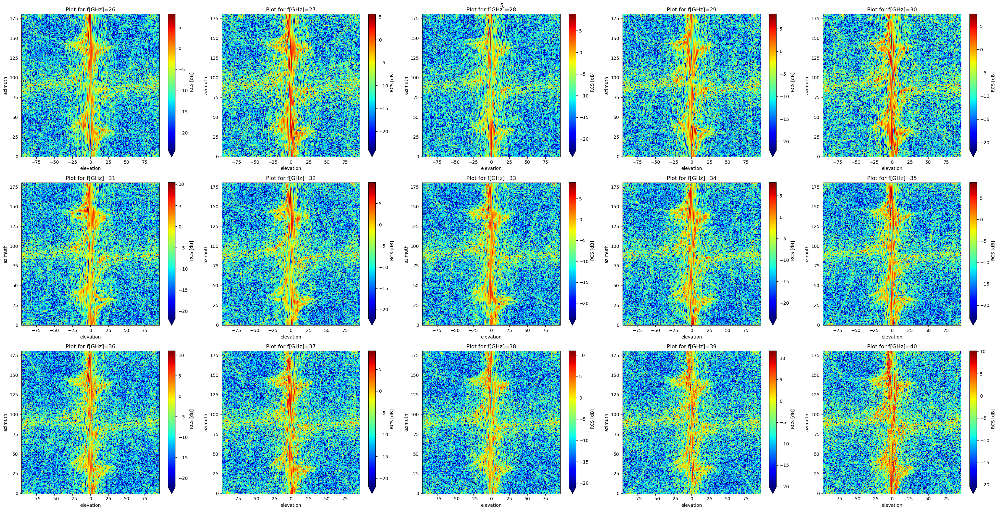

6
@26GHz Min RCS -69.609 , Max RCS 5.173
@27GHz Min RCS -61.344 , Max RCS 5.253
@28GHz Min RCS -54.120 , Max RCS 7.889
@29GHz Min RCS -63.043 , Max RCS 8.837
@30GHz Min RCS -61.451 , Max RCS 5.678
@31GHz Min RCS -62.864 , Max RCS 6.065
@32GHz Min RCS -54.980 , Max RCS 8.411
@33GHz Min RCS -69.639 , Max RCS 6.183
@34GHz Min RCS -61.857 , Max RCS 7.656
@35GHz Min RCS -65.094 , Max RCS 8.071
@36GHz Min RCS -60.374 , Max RCS 9.188
@37GHz Min RCS -86.042 , Max RCS 8.937
@38GHz Min RCS -57.333 , Max RCS 10.888
@39GHz Min RCS -55.984 , Max RCS 11.804
@40GHz Min RCS -60.624 , Max RCS 9.056



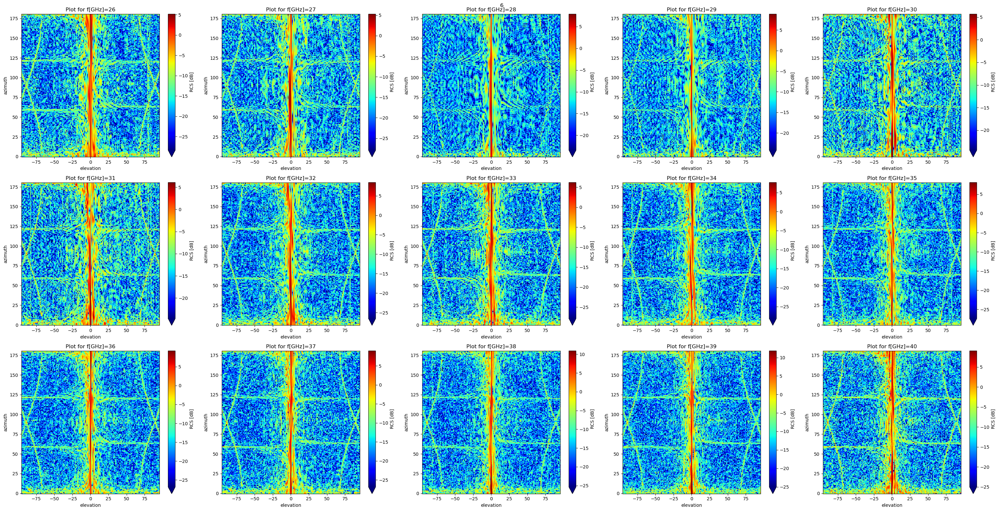

In [6]:
visualize_RCS_dictionary(drone_rcs)

### The azimuth and elevation ranges for the classes

In [12]:
for key,value in drone_rcs.items():
    print(f"key {key}")
    print(f"Shape {value.shape}")
    print(value.coords)

key 7
Shape (15, 91, 91)
Coordinates:
  * azimuth    (azimuth) int64 0 2 4 6 8 10 12 ... 168 170 172 174 176 178 180
  * elevation  (elevation) int64 -90 -88 -86 -84 -82 -80 ... 80 82 84 86 88 90
  * f[GHz]     (f[GHz]) int64 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40
key 0
Shape (15, 181, 181)
Coordinates:
  * azimuth    (azimuth) int64 0 1 2 3 4 5 6 7 ... 174 175 176 177 178 179 180
  * elevation  (elevation) int64 -90 -89 -88 -87 -86 -85 ... 85 86 87 88 89 90
  * f[GHz]     (f[GHz]) int64 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40
key 1
Shape (15, 181, 181)
Coordinates:
  * azimuth    (azimuth) int64 0 1 2 3 4 5 6 7 ... 174 175 176 177 178 179 180
  * elevation  (elevation) int64 -90 -89 -88 -87 -86 -85 ... 85 86 87 88 89 90
  * f[GHz]     (f[GHz]) int64 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40
key 2
Shape (15, 181, 181)
Coordinates:
  * azimuth    (azimuth) int64 0 1 2 3 4 5 6 7 ... 174 175 176 177 178 179 180
  * elevation  (elevation) int64 -90 -89 -88 -87 -86 -85 ... 85 

### Similarity Measures

In [13]:
def ssim_f(img1,img2,freq):
    el_intersect = np.intersect1d(img1.coords['elevation'],img2.coords['elevation'])
    az_intersect = np.intersect1d(img1.coords['azimuth'],img2.coords['azimuth'])

    img1 = img1.loc[freq,az_intersect,el_intersect].values
    img2 = img2.loc[freq,az_intersect,el_intersect].values

    minum = float(min(img1.min(),img2.min()))
    maxum = float(max(img1.max(),img2.max()))

#     img1 = img_as_float((img1-minum) / (maxum - minum))
#     img2 = img_as_float((img2-minum) / (maxum - minum))

    return ssim(img1,img2,data_range=maxum-minum)

In [14]:
def ms_ssim_f(img1,img2,freq):
    el_intersect = np.intersect1d(img1.coords['elevation'],img2.coords['elevation'])
    az_intersect = np.intersect1d(img1.coords['azimuth'],img2.coords['azimuth'])

    img1 = img1.loc[freq,az_intersect,el_intersect].values
    img2 = img2.loc[freq,az_intersect,el_intersect].values

    
    minum = float(min(img1.min(),img2.min()))
    maxum = float(max(img1.max(),img2.max()))
#     img1 = img_as_float((img1-minum) / (maxum - minum))
#     img2 = img_as_float((img2-minum) / (maxum - minum))
    

    
    try:
        ms_ssim = MultiScaleStructuralSimilarityIndexMeasure(data_range=maxum-minum,normalize=None)
    
        img1 = torch.FloatTensor(np.expand_dims(img1,[0,1]))
        img2 = torch.FloatTensor(np.expand_dims(img2,[0,1]))

        similarity = ms_ssim(img1,img2)
    
    
    except:
        ms_ssim = MultiScaleStructuralSimilarityIndexMeasure(data_range=maxum-minum,normalize=None,kernel_size=5,betas=(0.5,0.5))

        similarity = ms_ssim(img1,img2)#ssim(img1.squeeze().numpy(),img2.squeeze().numpy(),data_range=maxum-minum)
    
    return similarity #ms_ssim(img1,img2)#ssim(img1,img2,data_range=1.0)

In [15]:
def nrmse_f(img1,img2,freq):
    el_intersect = np.intersect1d(img1.coords['elevation'],img2.coords['elevation'])
    az_intersect = np.intersect1d(img1.coords['azimuth'],img2.coords['azimuth'])

    img1 = img1.loc[freq,az_intersect,el_intersect].values
    img2 = img2.loc[freq,az_intersect,el_intersect].values


    return nrmse(img1,img2,normalization='min-max')

In [16]:
def nmi_f(img1,img2,freq):
    el_intersect = np.intersect1d(img1.coords['elevation'],img2.coords['elevation'])
    az_intersect = np.intersect1d(img1.coords['azimuth'],img2.coords['azimuth'])

    img1 = img1.loc[freq,az_intersect,el_intersect].values
    img2 = img2.loc[freq,az_intersect,el_intersect].values


    return nmi(img1,img2)

In [33]:
def visualize_similarity(rcs_dict,similarity_fn,label_encoder,title=""):
    fig, axs = plt.subplots(3, 5, figsize=(31, 16))  # you can adjust the size as per your requirement

    # Flatten the 4x2 array to easily iterate over it
    axs = axs.flatten()
    
    N_classes = len(rcs_dict.keys())
    unique_frequencies = rcs_dict[0].coords["f[GHz]"].values
    unique_combinations = list(itertools.product(drone_rcs.keys(), drone_rcs.keys()))
    
    if similarity_fn == nmi_f:
        vmin = 1; vmax = 2
    elif similarity_fn in [ssim_f,ms_ssim_f]:
        vmin=-1; vmax= 1;
    else:
        vmin = 0; vmax = 1;
    
    
    for (freq, ax) in tqdm(zip(unique_frequencies, axs)):
        similarity_Matrix = np.zeros((N_classes,N_classes))

        for (i,j) in unique_combinations:
            similarity_Matrix[i,j] = similarity_fn(drone_rcs[i],drone_rcs[j],freq)
        
        im= ax.imshow(similarity_Matrix,cmap='jet',vmin=vmin,vmax=vmax)
        ax.set_title(f"Frequency={freq}",fontsize=20)
        divider = make_axes_locatable(ax)
        cax = divider.append_axes('right', size='5%', pad=0.05)
        fig.colorbar(im, cax=cax, orientation='vertical')

        ticks = np.arange(len(rcs_dict))
        ax.set_xticks(ticks,rotate=45)
        ax.set_yticks(ticks)
        ax.set_xticklabels(label_encoder.inverse_transform(ticks))
        ax.set_yticklabels(label_encoder.inverse_transform(ticks))
        plt.setp(ax.get_xticklabels(), rotation=45, ha="right")
        
    plt.suptitle(title,fontsize=20)
    plt.tight_layout()
    plt.show()

15it [00:05,  2.66it/s]


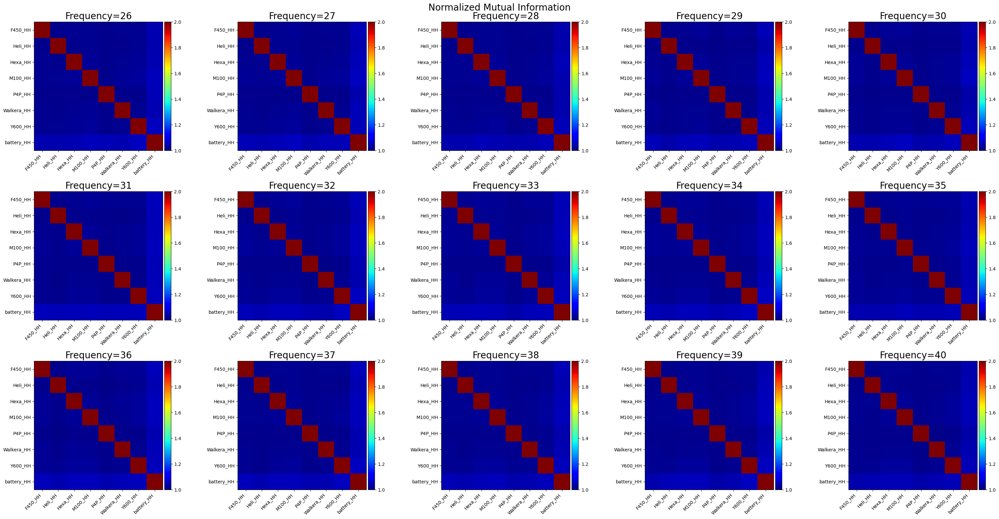

In [34]:
visualize_similarity(rcs_dict=drone_rcs,similarity_fn=nmi_f,label_encoder=labe_encoder,title="Normalized Mutual Information")

15it [00:06,  2.34it/s]


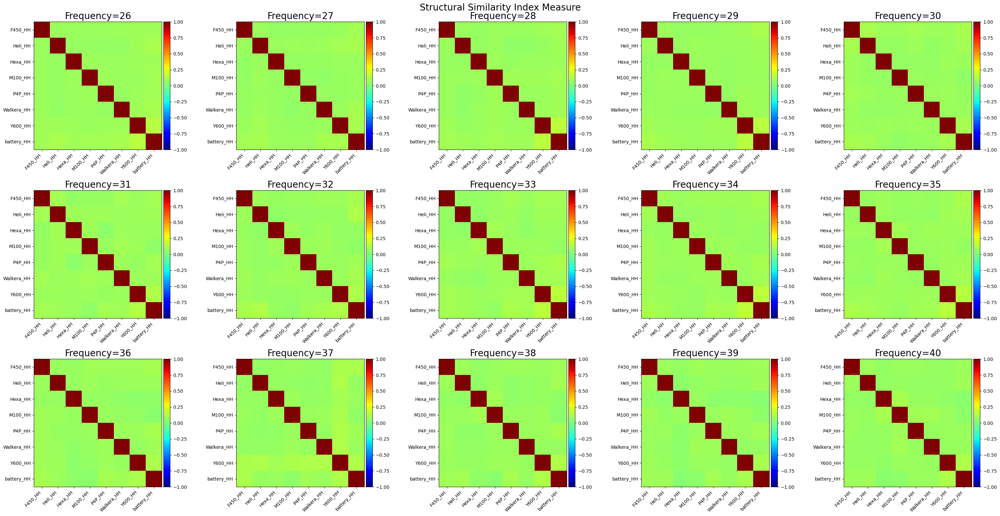

In [35]:
visualize_similarity(rcs_dict=drone_rcs,similarity_fn=ssim_f,label_encoder=labe_encoder,title="Structural Similarity Index Measure")

15it [00:15,  1.00s/it]


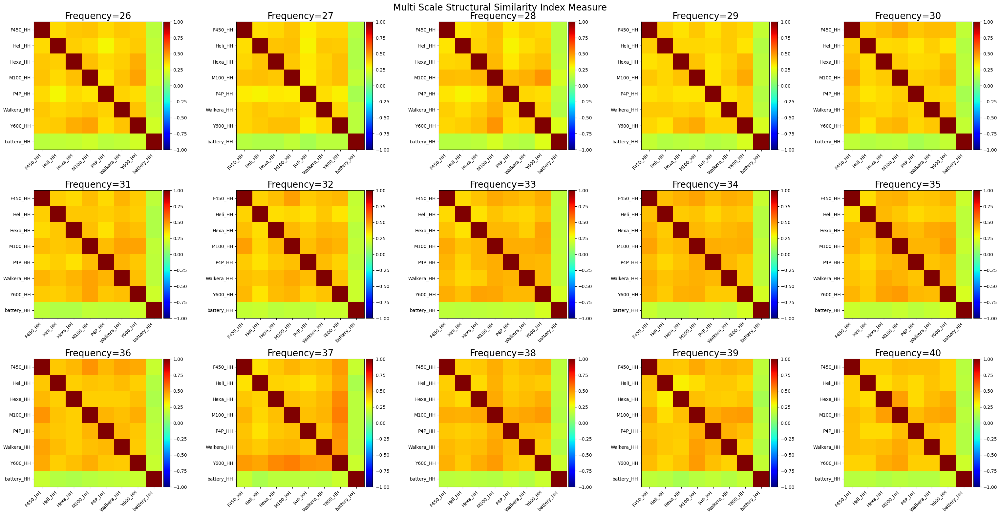

In [36]:
visualize_similarity(rcs_dict=drone_rcs,similarity_fn=ms_ssim_f,label_encoder=labe_encoder,title="Multi Scale Structural Similarity Index Measure")

In [14]:
import numpy as np
import matplotlib.pyplot as plt

from skimage import data, img_as_float
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import mean_squared_error


img = img_as_float(data.camera())
rows, cols = img.shape

noise = np.ones_like(img) * 0.2 * (img.max() - img.min())
rng = np.random.default_rng()
noise[rng.random(size=noise.shape) > 0.5] *= -1

img_noise = img + noise
img_const = img + abs(noise)


mse_none = mean_squared_error(img, img)
ssim_none = ssim(img, img, data_range=img.max() - img.min())

mse_noise = mean_squared_error(img, img_noise)
ssim_noise = ssim(img, img_noise,
                  data_range=img_noise.max() - img_noise.min())

mse_const = mean_squared_error(img, img_const)
ssim_const = ssim(img, img_const,
                  data_range=img_const.max() - img_const.min())

print(ssim_none,ssim_noise,ssim_const)

1.0 0.14505321244866876 0.8487230632381384


### Visualize RCS Distributions

In [15]:
def visualize_RCS_dist(rcs_dict):
    fig, axs = plt.subplots(3, 5, figsize=(31, 16))  # you can adjust the size as per your requirement

    # Flatten the 4x2 array to easily iterate over it
    axs = axs.flatten()
    
    N_classes = len(rcs_dict.keys())
    unique_frequencies = rcs_dict[0].coords["f[GHz]"].values
    
    cmap = colormaps.get_cmap('jet')
    rgba = cmap(np.linspace(0,1,N_classes))
    
    
    for i,(freq, ax) in enumerate(tqdm(zip(unique_frequencies, axs))):
        for j,color in enumerate(rgba):
            sns.histplot(drone_rcs[j].loc[freq].values.ravel(),color=rgba[j],alpha=0.5,stat="density",ax=ax)

        ax.set_title(f"Frequency={freq}")
        ax.legend(range(N_classes))
    plt.show()

In [16]:
cmap = colormaps.get_cmap('jet')
rgba = cmap(np.linspace(0,1,15))

15it [00:07,  1.99it/s]


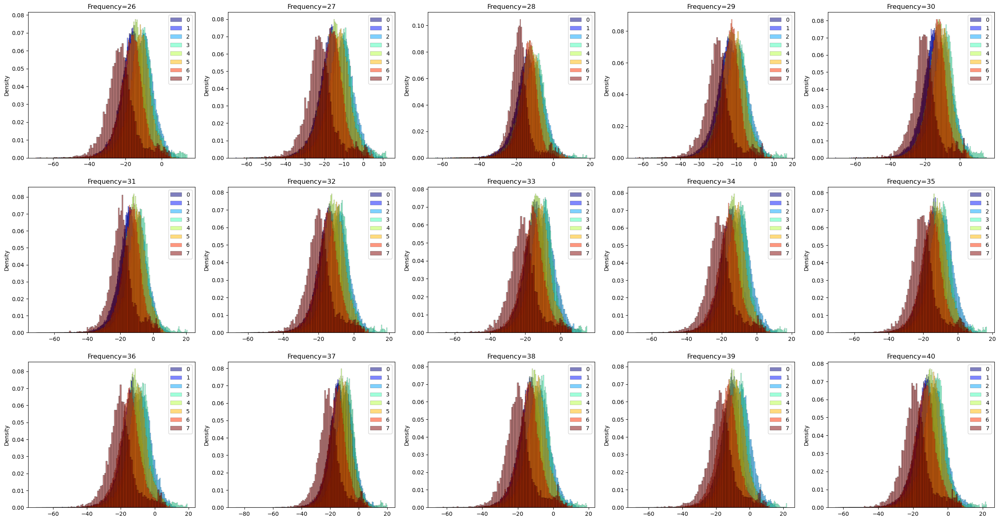

In [17]:
visualize_RCS_dist(rcs_dict=drone_rcs)

### UMAP Manifold

In [18]:
import umap
import umap.plot

C:\Users\lpott\anaconda3\envs\jaxtorch\lib\site-packages\dask\dataframe\_pyarrow_compat.py:17: FutureWarning: Minimal version of pyarrow will soon be increased to 14.0.1. You are using 10.0.1. Please consider upgrading.
  warnings.warn(
C:\Users\lpott\anaconda3\envs\jaxtorch\lib\site-packages\umap\plot.py:203: NumbaDeprecationWarning: The keyword argument 'nopython=False' was supplied. From Numba 0.59.0 the default is being changed to True and use of 'nopython=False' will raise a warning as the argument will have no effect. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit(nopython=False)


In [19]:
X = []; y = [];
for key,value in drone_rcs.items():
    X.append(value.values.reshape(15,-1).T)
    y.append(np.ones(np.prod(value.shape[1:]))*key)

X = np.vstack(X); y = np.hstack(y)
print("X: ",X.shape)
print("y: ",y.shape)

X:  (244848, 15)
y:  (244848,)


In [20]:
mapper = umap.UMAP().fit(X)

<AxesSubplot: >

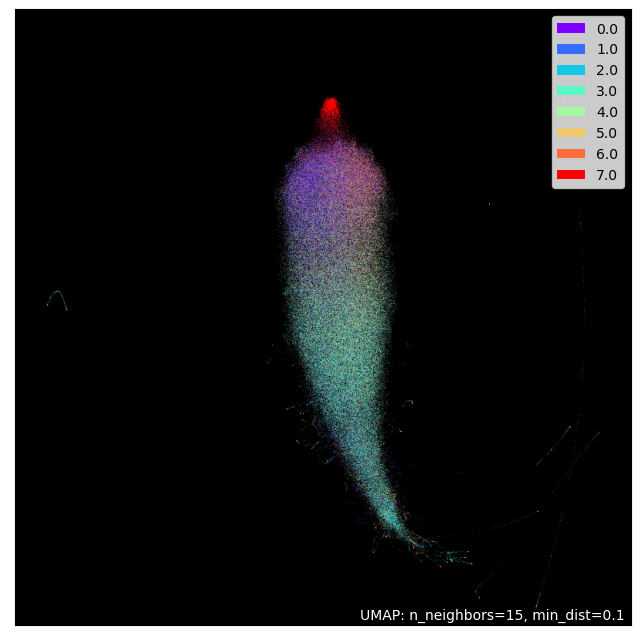

In [21]:
cmap = colormaps.get_cmap('tab20')

umap.plot.points(mapper, labels=y,theme='fire')

### TRY SIMPLE MODEL

In [22]:
from sklearn.metrics import classification_report,confusion_matrix, ConfusionMatrixDisplay
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split

In [23]:
X = []; y= []
size = 10000
for key,value in drone_rcs.items():
    el = np.random.choice(value.coords['elevation'],size=size)
    az = np.random.choice(value.coords['azimuth'],size=size)

    X.append(value.loc[:,xr.DataArray(az,dims="points"),xr.DataArray(el,dims="points")].T.values)
    y.append(np.ones(size,)*key)

In [24]:
X_data = np.vstack(X)
y_data = np.hstack(y)

X_tr,X_te,y_tr,y_te = train_test_split(X_data,y_data,stratify=y_data)

In [25]:
clf = XGBClassifier()
clf.fit(X_tr,y_tr)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)

In [26]:
y_pred = clf.predict(X_te)

In [27]:
print(classification_report(y_te,y_pred))

              precision    recall  f1-score   support

         0.0       0.41      0.36      0.38      2500
         1.0       0.36      0.28      0.31      2500
         2.0       0.44      0.50      0.47      2500
         3.0       0.43      0.56      0.49      2500
         4.0       0.35      0.33      0.34      2500
         5.0       0.37      0.36      0.37      2500
         6.0       0.46      0.45      0.46      2500
         7.0       0.88      0.89      0.89      2500

    accuracy                           0.47     20000
   macro avg       0.46      0.47      0.46     20000
weighted avg       0.46      0.47      0.46     20000



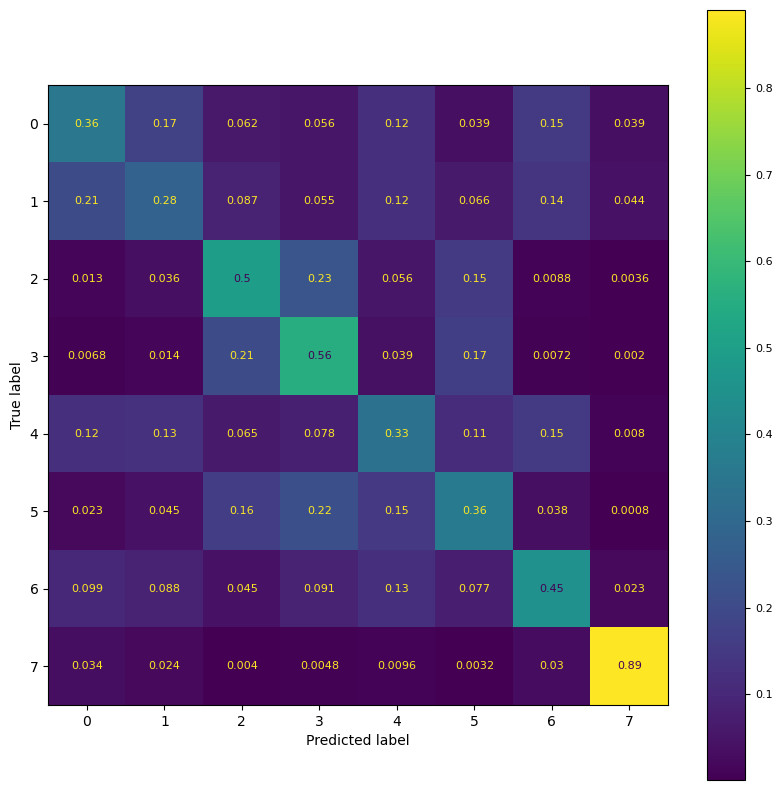

In [28]:
fig, ax = plt.subplots(figsize=(10,10))

plt.rcParams.update({'font.size': 8})

cm = confusion_matrix(y_te, y_pred, labels=clf.classes_,normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=clf.classes_)
disp.plot(ax=ax)
plt.show()